# COVID-19 - Kaggle Textos

- Link para o desafio: https://www.kaggle.com/allen-institute-for-ai/CORD-19-research-challenge
- Call to action: https://www.whitehouse.gov/briefings-statements/call-action-tech-community-new-machine-readable-covid-19-dataset/

## Instalação e importação das bibliotecas

In [1]:
#!pip install spacy
#!pip install scispacy
#!pip install wget
#!pip install wordcloud

In [2]:
#!pip install https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.2.4/en_core_sci_md-0.2.4.tar.gz

In [3]:
#!python -m spacy download en

In [4]:
import glob
import wget
import json
import nltk
import spacy
import zipfile
import scispacy
import numpy as np
import pandas as pd
import seaborn as sns
import en_core_sci_md
from matplotlib import pyplot as plt
from IPython.core.display import HTML

## Obter o dataset

Download do zip 
https://drive.google.com/file/d/1KwqHUm_gxTaeeGkOx5QmAqTGClcD54-F/view?usp=sharing

Salvar na pasta /dataset/

In [5]:
file = './datasets/CORD-19-research-challenge.zip'
zip_object = zipfile.ZipFile(file=file, mode='r')
zip_object.extractall('./datasets/CovidChallenge')
zip_object.close()

## Criação do dataframe com os textos

In [6]:
corona_features = {'paper_id': [], 'title': [], 'abstract': [], 'text': []}

In [7]:
type(corona_features)

dict

In [8]:
corona_df = pd.DataFrame.from_dict(corona_features)

In [9]:
type(corona_df)

pandas.core.frame.DataFrame

In [10]:
corona_df.head()

,paper_id,title,abstract,text


In [11]:
json_filenames = glob.glob(f'{"."}//**/*.json', recursive = True)

In [12]:
print(json_filenames)

e_subset\\ece140f2d510d370f594707b718066f7173a39e1.json', '.\\datasets\\CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ecf580f9baf30b1e7c860068c834f34d175dbda0.json', '.\\datasets\\CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ed21f99a11ebb65e8c3a6fb8d00b7141011916b0.json', '.\\datasets\\CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ed3dae51cc8af4b99b820ce4eaf28f9c9995b060.json', '.\\datasets\\CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ed52c50fb3ff01140790f21c6e9716a8cd3c9fa8.json', '.\\datasets\\CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ed610e3cb3696b2a25490d26ad19a1ef8229663d.json', '.\\datasets\\CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ed6b1dc674893e435945a5efbd1eef13a7c56bc1.json', '.\\datasets\\CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ed836dbe62d537006fc207428b489d208836a949.json', '.\\datasets\\CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ed94f0bd0fe17c099f8cdff4bf9edbbd29ebf41f.json'

In [13]:
len(json_filenames)

29315

In [14]:
def return_corona_df(json_filenames, df):
  for file_name in json_filenames:
    row = {'paper_id': None, 'title': None,
           'abstract': None, 'text': None}
    
    with open(file_name) as json_data:
      if file_name == './sample_data/anscombe.json':
        continue

      data = json.load(json_data)

      row['paper_id'] = data['paper_id'].strip() # ' 345 ' -> '345'
      row['title'] = data['metadata']['title'].strip()

      abstract_list = [abstract['text'] for abstract in data['abstract']]
      abstract = '\n '.join(abstract_list)
      row['abstract'] = abstract.strip()

      text_list = [text['text'] for text in data['body_text']]
      text = '\n '.join(text_list)
      row['text'] = text.strip()

      df = df.append(row, ignore_index = True)
  return df

In [15]:
corona_df = return_corona_df(json_filenames, corona_df)

In [16]:
corona_df.shape

(29315, 4)

In [17]:
corona_df.head()

,paper_id,title,abstract,text
0,0015023cc06b5362d332b3baf348d11567ca2fbb,The RNA pseudoknots in foot-and-mouth disease ...,word count: 194 22 Text word count: 5168 23 24...,"VP3, and VP0 (which is further processed to VP..."
1,004f0f8bb66cf446678dc13cf2701feec4f36d76,Healthcare-resource-adjusted vulnerabilities t...,,The 2019-nCoV epidemic has spread across China...
2,00d16927588fb04d4be0e6b269fc02f0d3c2aa7b,"Real-time, MinION-based, amplicon sequencing f...",Infectious bronchitis (IB) causes significant ...,"Infectious bronchitis (IB), which is caused by..."
3,0139ea4ca580af99b602c6435368e7fdbefacb03,A Combined Evidence Approach to Prioritize Nip...,Nipah Virus (NiV) came into limelight recently...,Nipah is an infectious negative-sense single-s...
4,013d9d1cba8a54d5d3718c229b812d7cf91b6c89,Assessing spread risk of Wuhan novel coronavir...,Background: A novel coronavirus (2019-nCoV) em...,"In December 2019, a cluster of patients with p..."


In [18]:
corona_df['text']

0        VP3, and VP0 (which is further processed to VP...
1        The 2019-nCoV epidemic has spread across China...
2        Infectious bronchitis (IB), which is caused by...
3        Nipah is an infectious negative-sense single-s...
4        In December 2019, a cluster of patients with p...
                               ...                        
29310    Regardless of geographic location, respiratory...
29311    Experiments were designed to test whether subs...
29312    can function in an autonomous fashion, relocat...
29313    Tick-borne encephalitis virus (TBEV) is a huma...
29314    20min). We trimmed the poly-A adaptors from th...
Name: text, Length: 29315, dtype: object

In [19]:
len(corona_df['text'])

29315

# Pré-processamento



## Valores faltantes

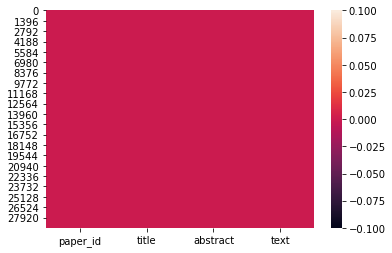

In [20]:
sns.heatmap(corona_df.isnull());

In [21]:
corona_df.shape

(29315, 4)

In [22]:
len(corona_df[corona_df['paper_id'] == ''])

0

In [23]:
len(corona_df[corona_df['title'] == ''])

3583

In [24]:
len(corona_df[corona_df['abstract'] == ''])

8051

In [25]:
len(corona_df[corona_df['text'] == ''])

0

In [26]:
corona_df = corona_df[corona_df['title'] != '']

In [27]:
corona_df = corona_df[corona_df['abstract'] != '']

In [28]:
corona_df.shape

(20343, 4)

## Valores duplicados

In [29]:
corona_df.drop_duplicates(['abstract', 'text', 'title'], inplace = True)

In [30]:
corona_df.shape

(20211, 4)

In [31]:
corona_df.to_csv('./datasets/corona_df_completo.csv')

## Amostra da base de dados

In [32]:
corona_df = corona_df.sample(n = 500, random_state=1)

In [33]:
corona_df.shape

(500, 4)

In [34]:
corona_df.head()

,paper_id,title,abstract,text
7507,b890aa8cb8a15fec0f4bb8e970f5a21fd2dfda33,BMC Veterinary Research Loop-mediated isotherm...,Background: Enteric Redmouth (ERM) disease als...,Yersiniosis or enteric red mouth disease (ERM)...
9101,e572a3a154399f2b500b0f547a7252c94580acf4,Prediction of High Incidence of Dengue in the ...,Background: Accurate prediction of dengue inci...,Dengue fever is a common human viral disease t...
1025,03dce266594748330a10d2d11dbe611bf42aa42d,"MINI REVIEW Rhinovirus Biology, Antigenic Dive...",Human rhinovirus (HRV) remains a leading cause...,Human rhinoviruses (HRVs) are respiratory viru...
7792,c13377750d32446f66a4bcd0bb2da626e4b2a035,Pilgrims and MERS-CoV: what's the risk?,The risk of Middle East Respiratory Syndrome C...,"A decade after SARS, another coronavirus assoc..."
738,db142fe07544dcf0e454f8a9f39452f0aa92a6ca,Kidney impairment is associated with in-hospit...,Background: Information on kidney impairment i...,"In December 2019, a series of unknown origins ..."


In [35]:
corona_df.tail()

,paper_id,title,abstract,text
23234,c7f00c1af00cd27223dd8cb5020788e4e06e48cc,"Design, synthesis, and evaluation of trifluoro...",A series of trifluoromethyl ketones as SARS-Co...,Severe acute respiratory syndrome-associated c...
155,2e7c17caecfe67b64f9b59df404f0761df96987f,National and Regional Influenza-Like-Illness F...,Health planners use forecasts of key metrics a...,Basic model 98 The DICE package has been desig...
21344,aabe5fd7d75d19ba4daca67de64e0b2db4a05d6e,Synthesis of fluorinated acyclic nucleoside ph...,With respect to the strong antiviral activity ...,The chemistry of acyclic nucleoside phosphonat...
19815,938a53e7f870ea74d6347fe145f7ec1d9c657aaf,Liver STRUCTURE AND FUNCTION,The hepatic lobule is the anatomic unit of the...,The basic elements of the biliary tract are th...
21203,a89de2302bef8efe03fb937119e00142397a2083,Infectious diseases in large-scale cat hoardin...,Animal hoarders accumulate animals in over-cro...,Animal hoarding is a complex human and animal ...


In [38]:
sample_text = corona_df['text'][155]
sample_text

ion. In this 102 scenario, the rate at which a susceptible person in region j becomes infectious (that is 103 transitions to the I compartment in region j) depends on: (1) the risk of infection from 104 those in the same region j, (2) the risk of infection from infected people from region i 105 who traveled to region j, and (3) the risk of infection encountered when traveling from 106 region j to region i. To account for the three mechanisms of transmission, ref [24] 107 defined the force of infection, or the average rate that susceptible individuals in region i 108 become infected per time step as:\n where D is the total number of regions. In our case, unlike reference [24] , the 110 transmissibility is not the same for all regions and it is allowed to depend on time: β j (t). 111\n Given this force of infection we can write the coupled S-I-R equations for each region as:\n in the mobility matrix is one and in the limit of no mobility between regions the mobility matrix m ij is the id

## Função para pré-processamento

In [39]:
nlp = en_core_sci_md.load(disable=['tagger', 'parser', 'ner'])
nlp.max_length = 2000000

In [40]:
print(spacy.lang.en.stop_words.STOP_WORDS)

{'’re', 'otherwise', 'see', 'besides', 'doing', 'what', 'never', 'whence', 'not', 'was', 'own', 'quite', 'last', 'thus', 'always', 'up', 'without', 'regarding', 'these', 'whatever', 'empty', 'because', 'somehow', 'twenty', 'they', 'used', 'his', 'sometimes', "'ve", '’m', '’d', 'several', 'whereas', 'toward', 'n‘t', 'make', 'due', 'thereupon', 'side', 'hundred', 'between', 'further', 'if', 'becomes', 'bottom', 'nevertheless', 'done', 'back', 'first', 'one', 'after', 'while', 'mine', 'their', 'some', 'may', 'there', 'over', 'whenever', '’ve', 'above', 'amongst', 'whereafter', 'eleven', 'seems', 'with', 'next', 'no', 'n’t', 'anything', 'except', 'he', 'him', '’s', 'upon', 'put', 'each', 'wherever', 'ours', 'cannot', 'than', 'you', 'but', 'enough', 'former', 'name', 'say', 'against', 'off', 'by', 'herself', 'her', 'nor', 'thence', 'using', 'and', 'most', 'in', 'have', 'really', 'too', 'less', 'other', 'hence', 'nine', 'seeming', 'thereafter', 'our', 'often', 'give', 'few', 'same', 'which',

In [41]:
len(spacy.lang.en.stop_words.STOP_WORDS)

326

In [42]:
new_stop_words = ['et', 'al', 'doi', 'copyright', 'http', 'https', 'fig', 'table', 'result', 'show']
for word in new_stop_words:
  nlp.vocab[word].is_stop = True

In [43]:
def spacy_tokenizer(sentence):
  sentence = sentence.lower()
  list = []
  list = [word.lemma_ for word in nlp(sentence) if not (word.is_stop or
                                                        word.like_num or
                                                        word.is_punct or
                                                        word.is_space or
                                                        len(word) == 1)]
  list = ' '.join([str(element) for element in list])

  return list

In [44]:
sample_text

ion. In this 102 scenario, the rate at which a susceptible person in region j becomes infectious (that is 103 transitions to the I compartment in region j) depends on: (1) the risk of infection from 104 those in the same region j, (2) the risk of infection from infected people from region i 105 who traveled to region j, and (3) the risk of infection encountered when traveling from 106 region j to region i. To account for the three mechanisms of transmission, ref [24] 107 defined the force of infection, or the average rate that susceptible individuals in region i 108 become infected per time step as:\n where D is the total number of regions. In our case, unlike reference [24] , the 110 transmissibility is not the same for all regions and it is allowed to depend on time: β j (t). 111\n Given this force of infection we can write the coupled S-I-R equations for each region as:\n in the mobility matrix is one and in the limit of no mobility between regions the mobility matrix m ij is the id

In [45]:
test = '1 ' + sample_text
test

ion. In this 102 scenario, the rate at which a susceptible person in region j becomes infectious (that is 103 transitions to the I compartment in region j) depends on: (1) the risk of infection from 104 those in the same region j, (2) the risk of infection from infected people from region i 105 who traveled to region j, and (3) the risk of infection encountered when traveling from 106 region j to region i. To account for the three mechanisms of transmission, ref [24] 107 defined the force of infection, or the average rate that susceptible individuals in region i 108 become infected per time step as:\n where D is the total number of regions. In our case, unlike reference [24] , the 110 transmissibility is not the same for all regions and it is allowed to depend on time: β j (t). 111\n Given this force of infection we can write the coupled S-I-R equations for each region as:\n in the mobility matrix is one and in the limit of no mobility between regions the mobility matrix m ij is the id

In [46]:
result = spacy_tokenizer(test)
result

'basic model die package design implement meta-population epidemic model arbitrary spatial scale couple region model couple spatial region follow ref assume system couple s-i-r equation susceptible-infectious-recovered spatial region scenario rate susceptible person region infectious transition compartment region depend risk infection region risk infection infect people region travel region risk infection encounter travel region region i. account mechanism transmission ref define force infection average rate susceptible individual region infect time step total numb region case unlike reference transmissibility region allow depend time give force infection write couple s-i-r equation region mobility matrix limit mobility region mobility matrix ij identity matrix ii ni recover familiar uncouple s-i-r equation level interaction spatial region determine mobility matrix interaction kernel κ(r ij kernel expect depend geographic distance region ij follow mill riley use variation off-set power

In [47]:
corona_df['text'] = corona_df['text'].apply(spacy_tokenizer)

In [48]:
print(sample_text)

ctious-recovered) for each spatial region. In this 102 scenario, the rate at which a susceptible person in region j becomes infectious (that is 103 transitions to the I compartment in region j) depends on: (1) the risk of infection from 104 those in the same region j, (2) the risk of infection from infected people from region i 105 who traveled to region j, and (3) the risk of infection encountered when traveling from 106 region j to region i. To account for the three mechanisms of transmission, ref [24] 107 defined the force of infection, or the average rate that susceptible individuals in region i 108 become infected per time step as:
 where D is the total number of regions. In our case, unlike reference [24] , the 110 transmissibility is not the same for all regions and it is allowed to depend on time: β j (t). 111
 Given this force of infection we can write the coupled S-I-R equations for each region as:
 in the mobility matrix is one and in the limit of no mobility between regions

In [49]:
len(sample_text)

20312

In [50]:
print(corona_df['text'][155])

basic model die package design implement meta-population epidemic model arbitrary spatial scale couple region model couple spatial region follow ref assume system couple s-i-r equation susceptible-infectious-recovered spatial region scenario rate susceptible person region infectious transition compartment region depend risk infection region risk infection infect people region travel region risk infection encounter travel region region i. account mechanism transmission ref define force infection average rate susceptible individual region infect time step total numb region case unlike reference transmissibility region allow depend time give force infection write couple s-i-r equation region mobility matrix limit mobility region mobility matrix ij identity matrix ii ni recover familiar uncouple s-i-r equation level interaction spatial region determine mobility matrix interaction kernel κ(r ij kernel expect depend geographic distance region ij follow mill riley use variation off-set power 

In [51]:
len(corona_df['text'][155])

11425

# Termos frequentes

In [52]:
if not os.path.exists('./datasets/corpus'):
    os.makedirs('./datasets/corpus')

In [53]:
for index, row in corona_df.iterrows():
  print(row['paper_id'], row['title'])
  file = './datasets/corpus/' + row['paper_id'] + '.txt'
  
  with open(file, 'w', encoding='utf-8') as f:
    f.write(row['text'])

c2c03b16f022 Porcine reproductive and respiratory syndrome virus field isolates differ in in vitro interferon phenotypes
4660da2a8603d28150c9d3de1a17c0333094087c Histopathology of Pneumocystis carinii pneumonia in immunocompetent laboratory rats
e92b5c036c9ce25108a60ce3ec7464c78b9a0b4a Comparison of immunofluorescence with monoclonal antibodies and RT-PCR for the detection of human coronaviruses 229E and OC43 in cell culture
a05179c57d5e1cdddc839ff3c0b70a614efbb6cb Host and infectivity prediction of Wuhan 2019 novel coronavirus using deep learning algorithm
118ba92ce2640b2fb2bd7f5184a3251b5fd6a55e Diagnóstico rápido de las infecciones del tracto gastrointestinal por parásitos, virus y bacterias
537aa0a30e33e4a84bf6c6226e4f377b826c1b65 The airborne transmission of infection between flats in high-rise residential buildings: A review
2cbf0c99c7d0ea1b6418efc0037b46f21d205895 Clinical signs, reproduction of attaching/ effacing lesions, and enterocyte invasion after oral inoculation of an O1

In [54]:
from nltk.corpus import PlaintextCorpusReader
corpus = PlaintextCorpusReader('./datasets/corpus', '.*')

In [55]:
files = corpus.fileids()

In [56]:
files[0]

'018a299cbdcbebd6f4c2584376941907fe7d3aaf.txt'

In [58]:
corpus.raw('018a299cbdcbebd6f4c2584376941907fe7d3aaf.txt')

"helm associate work suggest government public relation distinguish corporate public relation nature scope especially time acute crisis government level responsibility complexity communication layer degree public medium scrutiny far exceed private sector specifically factor characterize uniqueness government crisis identify study buus olsson helm hiebert naver rabin liu horsley rosenthal kouzmin viteritti crisis raise question ineffectiveness government authority prevention containment crisis magnify exist problem government devaluation communication crisis occur medium scrutiny intensify government crisis handling constitute public accumulate collective memory evaluate government crisis public see government crisis thematic episodic nature-that evaluate crisis broad context product government leadership relation specific episode public interpret government crisis communication reflection government prioritize public good crisis hit bureaucratic nature tel public sector magnify eye pub

In [59]:
words = corpus.words()
print(words)

['helm', 'associate', 'work', 'suggest', 'government', ...]


In [60]:
len(words)

1718359

In [61]:
frequency = nltk.FreqDist(words)
most_common = frequency.most_common(100)
most_common

[('-', 62224),
 ('.', 24773),
 ('cell', 14167),
 ('di', 12136),
 ("'", 10806),
 ('/', 10150),
 ('virus', 9928),
 ('al', 9626),
 ('la', 9587),
 ('protein', 8006),
 ('study', 7130),
 ('infection', 7115),
 ('l', 6531),
 ('de', 6012),
 ('show', 5080),
 ('il', 4725),
 ('viral', 4476),
 ('le', 4329),
 ('patient', 4273),
 ('1', 3992),
 ('high', 3944),
 ('disease', 3896),
 ('result', 3895),
 ('datum', 3862),
 ('un', 3683),
 ('human', 3611),
 ('gene', 3502),
 ('fig', 3499),
 ('sequence', 3452),
 ('sample', 3371),
 ('increase', 3351),
 ('control', 3299),
 ('group', 3296),
 ('level', 3263),
 ('test', 3252),
 ('time', 3198),
 ('include', 3139),
 ('figure', 3096),
 ('strain', 3083),
 ('case', 3064),
 ('analysis', 2986),
 ('rna', 2916),
 ('type', 2896),
 ('report', 2879),
 ('les', 2806),
 ('mouse', 2800),
 ('expression', 2746),
 ('day', 2666),
 ('activity', 2652),
 ('different', 2635),
 ('model', 2626),
 ('antibody', 2619),
 ('del', 2616),
 ('infect', 2543),
 ('find', 2516),
 ('non', 2506),
 ('speci

# Nuvem de palavras

In [62]:
from matplotlib.colors import ListedColormap
color_map = ListedColormap(['orange', 'green', 'red', 'magenta'])

In [63]:
from wordcloud import WordCloud
cloud = WordCloud(background_color = 'white', max_words=100, colormap=color_map)

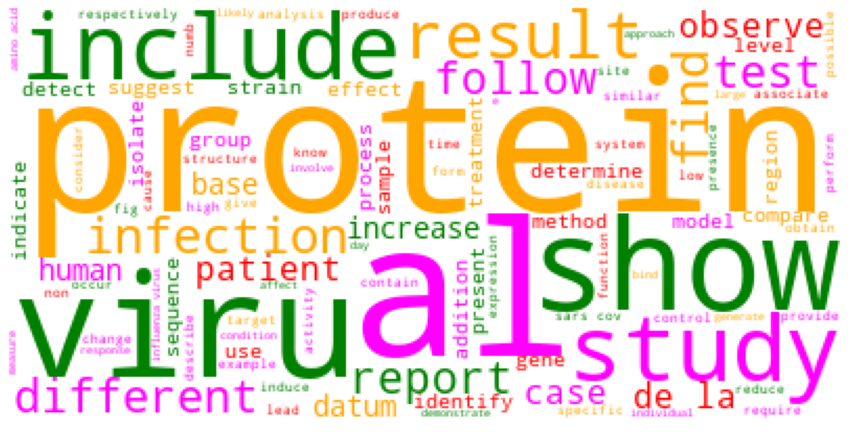

In [64]:
cloud = cloud.generate(corona_df['text'].str.cat(sep='\n'))
plt.figure(figsize=(15,15))
plt.imshow(cloud)
plt.axis('off')
plt.show()

In [65]:
corona_df.to_csv('./datasets/corona_df.csv')

# Extração de entidades nomeadas

## Testes com a função

In [66]:
text = str(corona_df['text'][155])
print(text)

basic model die package design implement meta-population epidemic model arbitrary spatial scale couple region model couple spatial region follow ref assume system couple s-i-r equation susceptible-infectious-recovered spatial region scenario rate susceptible person region infectious transition compartment region depend risk infection region risk infection infect people region travel region risk infection encounter travel region region i. account mechanism transmission ref define force infection average rate susceptible individual region infect time step total numb region case unlike reference transmissibility region allow depend time give force infection write couple s-i-r equation region mobility matrix limit mobility region mobility matrix ij identity matrix ii ni recover familiar uncouple s-i-r equation level interaction spatial region determine mobility matrix interaction kernel κ(r ij kernel expect depend geographic distance region ij follow mill riley use variation off-set power 

In [67]:
nlp_ent = spacy.load('en')
nlp_ent.max_length = 2000000

In [68]:
doc = nlp_ent(text)

In [69]:
for entity in doc.ents:
  if entity.label_ == 'NORP' or entity.label_ == 'GPE':
    print(entity.text, entity.label_)

ew06 NORP


In [70]:
from spacy import displacy
displacy.render(doc, style = 'ent', jupyter = True)

## Contagem das entidades na base de dados

In [71]:
gpe = []
for index, row in corona_df.iterrows():
  text = row['text']
  doc = nlp_ent(text)
  for entity in doc.ents:
    if entity.label_ == 'GPE':
      gpe.append(str(entity.text))

In [72]:
print(gpe)

', 'mannan', 'neutrophil', 'neutrophil', 'maryland', 'eritoran', 'eritoran', 'eritoran', 'ligand', 'ireland', 'ligand', 'ligand', 'yersinia', 'san diego usa', 'eritoran', 'mrna', 'ml −1', 'mrna', 'mrna', 'mrna', 'ml −1', 'ml −1 iqr', 'ml −1', 'mrna', 'iav sp14', 'ml −1', 'ml −1', 'ml −1', 'geneva', 'switzerland', 'mrna', 'hilden', 'germany', 'mrna', 'germany', 'mrna', 'roc', 'la jolla', 'california', 'belgium', 'germany', 'france', 'italy', 'portugal', 'netherlands', 'slovenia', 'usa', 'denmark', 'sweden', 'uk', 'denmark', 'italy', 'france', 'netherlands', 'sweden', 'uk', 'canada', 'italy', 'italy', 'antigen', 'canada', 'canada', 'france', 'canada', 'iowa', 'canada', 'italy', 'germany', 'elisas', 'italy', 'elisas', 'elisas', 'france', 'france', 'italy', 'italy', 'china', 'russia', 'naïve county', 'italy', 'germany', 'south africa', 'china', 'germany', 'egypt', 'poland', 'italy', 'netherlands', 'france', 'spain', 'kingdom', 'ukraine', 'south africa', 'italy', 'turkey', 'spain', 'egypt',

In [73]:
values_gpe, counts_gpe = np.unique(np.array(gpe), return_counts = True)

In [74]:
gpe_df = pd.DataFrame({'value': values_gpe, 'counts': counts_gpe})

In [75]:
gpe_df.head()

,value,counts
0,-abp,3
1,-adattamento,1
2,-agcacccagtccgccctgagca-3,1
3,-alanine,1
4,-anestesia,2


In [76]:
gpe_df.shape

(2985, 2)

In [77]:
gpe_df_filtered = gpe_df[gpe_df.counts > 50]

In [78]:
gpe_df_filtered.shape

(28, 2)

In [79]:
gpe_df_filtered

,value,counts
66,al.,61
142,ammonia,70
285,beijing,62
361,canada,57
417,china,413
638,delle,266
953,france,52
993,germany,130
1116,hong kong,184
1198,il,148


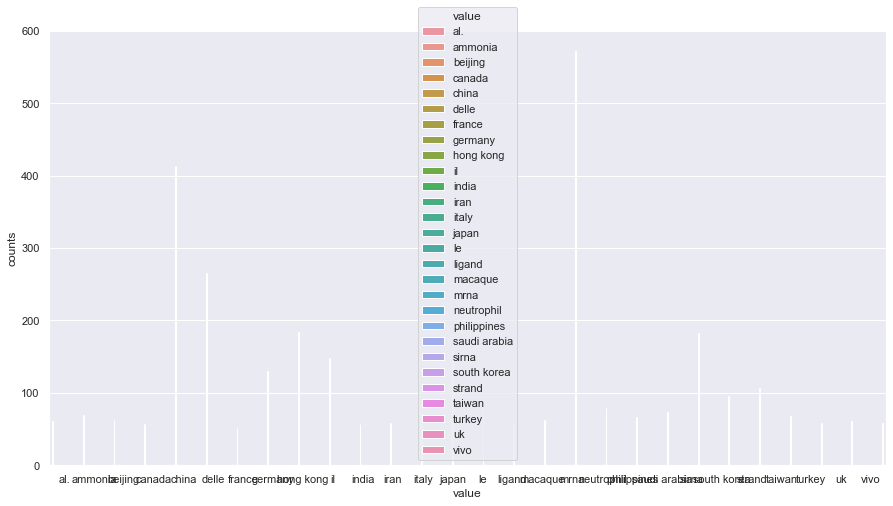

In [80]:
sns.set(rc={'figure.figsize': (15,8)})
sns.barplot(x = 'value', y = 'counts', hue='value', data=gpe_df_filtered);

# Textos utilizados para pesquisa

## What do we know about COVID-19 risk factors?

- Smoking, 
- pre-existing pulmonary disease
- Co-infections (determine whether co-existing respiratory/viral infections make the virus more transmissible or virulent) and other - co-morbidities
- Neonates and pregnant women
- Socio-economic and behavioral factors to understand the economic impact of the virus and whether there were differences

## What do we know about non-pharmaceutical interventions?

- Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases.
Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments.




# Pesquisa com uma palavra e NLTK

In [81]:
text = nltk.Text(corpus.words())

In [82]:
match = text.concordance('pulmonary', width = 150, lines=30)

Displaying 30 of 261 matches:
ion indicate acute respiratory distress syndrome ards leave lung show pulmonary edema hyaline membrane formation suggestive early - phase ards pathol
destruction produce virus host response extensive severely compromise pulmonary function efficient suppression early viral replication minimization i
n immune - mediated injury quintessential hallmark effective recovery pulmonary viral infection review discuss recent development process innate immu
 repair / regeneration respiratory epithelial cell return homeostatic pulmonary function lung impair adaptive immune response reduce cytokine / chemo
innate immunity evolve important bridge innate adaptive immune system pulmonary viral infection complement activation locally lung systemically compl
r cd8 cell transpresentation il - 15 dc - expressed il - 15ra patient pulmonary viral infection dcs play important role modulate antiviral t - cell r
tory cytokine lead enhance inflammation injury result immunopathology 

In [83]:
type(match)

NoneType

# Pesquisa com uma palavra e "find"

## Testando o método "find"

In [84]:
string = 'spread wuhan city china infect traveller cause sporadic secondary transmission city secondary city epidemic'
search_string = 'city'

In [85]:
print(string.find(search_string))

13


In [86]:
string[13]

'c'

In [87]:
string[13:13+10]

'city china'

In [88]:
string[13-10:13]

'ead wuhan '

In [89]:
string[13:13+10000]

'city china infect traveller cause sporadic secondary transmission city secondary city epidemic'

In [90]:
# Código baseado em: https://www.journaldev.com/23666/python-string-find
def find_texts(input_str, search_str, number_of_words):
  l = []
  index = 0
  number_of_words = number_of_words
  while index < len(input_str):
    i = input_str.find(search_str, index)
    if i == -1:
      return l
    
    if input_str[i-number_of_words:i] == '':
      start = 0
    else:
      start = i - number_of_words

    l.append(input_str[start:i] + input_str[i:i+number_of_words])
    index = i + 1
  return l

In [91]:
texts = find_texts(string, search_string, 50)
texts

['spread wuhan city china infect traveller cause sporadic seconda',
 't traveller cause sporadic secondary transmission city secondary city epidemic',
 'se sporadic secondary transmission city secondary city epidemic']

In [92]:
display(HTML(f'<h1>{search_string.upper()}</h1>'))
display(HTML(f"""<p><strong>Number of matches:</strong> {len(texts)}</p>"""))
for i in texts:
  #print(i)
  marked_text = str(i.replace(search_string, f"<mark>{search_string}</mark>"))
  #print(marked_text)
  display(HTML(f"""<blockquote>... {marked_text} ...</blockquote>"""))

## Aplicação na base de dados

In [93]:
search_string = 'pulmonary disease'

In [94]:
search_string = spacy_tokenizer(search_string)
search_string

'pulmonary disease'

In [95]:
def find_all_texts(input_str, search_str, number_of_words):
  text_list = []
  index = 0
  number_of_words = number_of_words
  while index < len(input_str):
    i = input_str.find(search_str, index)
    if i == -1:
      return text_list
    
    if input_str[i-number_of_words:i] == '':
      start = 0
    else:
      start = i - number_of_words

    text_list.append(input_str[start:i] + input_str[i:i+number_of_words])
    index = i + 1
  return text_list

In [96]:
documents = []
for index, row in corona_df.iterrows():
  documents.append(find_all_texts(row['text'], search_string, 40))

In [97]:
len(documents)

500

In [98]:
for doc in documents:
  if doc != []:
    print(doc)

['te respiratory syndrome sars infectious pulmonary disease appear originate south']
['dity review patient chronic obstructive pulmonary disease asthma bronchiectasis ']
['istress lung oedema chronic obstructive pulmonary disease copd exacerbation sign']
['respiratory disease chronic obstructive pulmonary disease copd active tb predisp']
[' associate progress chronic obstructive pulmonary disease copd highly correlate ']
['cular bronchiolitis lymphoproliferative pulmonary disease human classification s']
['resent frailty immunologic weaken cardiopulmonary disease understand predispose ']
['s nutritional status stress level cardiopulmonary disease infl uence host factor']
['l al. demonstrate presence inflammatory pulmonary disease compute tomography ct ', 'have infectious pneumonia noninfectious pulmonary disease extrathoracic fever fo']
['isease hypertension chronic obstructive pulmonary disease lymphocytopenia observ']
['t age year diabetes chronic obstructive pulmonary disease copd n

In [99]:
for index, row in corona_df.iterrows():
  texts = find_all_texts(row['text'], search_string, 400)
  if texts == []:
    continue
  
  paper_id = row['paper_id']
  title = row['title']
  display(HTML(f'<h1>{search_string.upper()}</h1>'))
  display(HTML(f"""<p>
                      <strong>Title:</strong> {title}</br>
                      <strong>ID:</strong> {paper_id}</br>
                      <strong>Number of matches:</strong> {len(texts)}
                   </p>"""))
  for i in texts:
    marked_text = str(i.replace(search_string, f"<mark>{search_string}</mark>"))
    display(HTML(f"""<blockquote>... {marked_text} ...</blockquote>"""))  


Vantagens
- Rápido
- Fácil implementação
- Muito útil para pesquisas simples com uma palavra
- Bom para palavras-chave

Desvantagens
- Somente uma palavra-chave
- Não possui ordenação de importância
- Considera somente a palavra "completa"

# Pesquisa com mais palavras e spaCy

## Testando o spaCy

In [100]:
string = 'spread wuhan city china infect traveller cause sporadic secondary transmission city secondary city epidemic'

In [101]:
search_strings = ['city', 'traveller']
tokens_list = [nlp(item) for item in search_strings]

In [102]:
tokens_list

[city, traveller]

In [103]:
print(nlp.vocab)

In [104]:
from spacy.matcher import PhraseMatcher
matcher = PhraseMatcher(nlp.vocab)
matcher.add('SEARCH', None, *tokens_list)

In [105]:
doc = nlp(string)
matches = matcher(doc)
matches

[(8661325627334373315, 2, 3),
 (8661325627334373315, 5, 6),
 (8661325627334373315, 10, 11),
 (8661325627334373315, 12, 13)]

In [106]:
doc[2:3]

city

In [107]:
doc[5:6]

traveller

In [108]:
doc[10:11]

city

In [109]:
doc[12:13]

city

In [110]:
doc[10-5:10+5]

traveller cause sporadic secondary transmission city secondary city epidemic

In [111]:
matches[0]

(8661325627334373315, 2, 3)

In [112]:
matches[0][1]

2

In [113]:
matches[0][2]

3

In [114]:
doc[matches[0][1]:matches[0][2]]

city

## Aplicação na base de dados

In [115]:
search_strings = ['smoking', 'pulmonary disease']
tokens_list = [nlp(spacy_tokenizer(item)) for item in search_strings]
tokens_list

[smoke, pulmonary disease]

In [116]:
from spacy.matcher import PhraseMatcher
matcher = PhraseMatcher(nlp.vocab)
matcher.add('SEARCH', None, *tokens_list)
number_of_words = 50

In [117]:
search_strings_html = ' '.join([str(element) for element in search_strings])
search_strings_html

'smoking pulmonary disease'

In [118]:
for index, row in corona_df.iterrows():
  marked_text = ''
  doc = nlp(row['text'])
  paper_id = row['paper_id']
  title = row['title']
  matches = matcher(doc)
  if matches == []:
    continue

  display(HTML(f'<h1>{search_strings_html.upper()}</h1>'))
  display(HTML(f"""<p>
                      <strong>Title:</strong> {title}</br>
                      <strong>ID:</strong> {paper_id}</br>
                      <strong>Number of matches:</strong> {len(matches)}
                   </p>"""))
  for i in matches:
    start = i[1] - number_of_words
    if start < 0:
      start = 0
    for j in range(len(tokens_list)):
      if doc[i[1]:i[2]].similarity(tokens_list[j]) == 1.0:
        search_text = str(tokens_list[j])
        marked_text += str(doc[start:i[2] + number_of_words]).replace(search_text, f"<mark>{search_text}</mark>")
        marked_text += "<br /><br />"
  display(HTML(f"""<blockquote>... {marked_text} ...</blockquote>"""))

Vantagens
- Fácil implementação
- Muito útil para pesquisas simples com mais palavras
- Bom para palavras-chave
- Usa uma biblioteca própria para processamento de linguagem natural

Desvantagens
- Não possui ordenação de importância

# Similaridade entre strings com fuzzywuzzy

- Distância Levenshtein: https://pt.wikipedia.org/wiki/Dist%C3%A2ncia_Levenshtein

## Testes com o fuzzywuzzy

In [119]:
#!pip install fuzzywuzzy

In [ ]:
#!pip install python-Levenshtein

In [120]:
from fuzzywuzzy import fuzz

In [121]:
# Similaridade da string em ordem
fuzz.ratio('Apple Inc.', 'Apple')

67

In [122]:
# Similaridade da string parcial
fuzz.partial_ratio('Apple Inc.', 'Apple')

100

In [123]:
# Ignora a ordem das palavras
fuzz.token_sort_ratio('Lakers x Chigaco Bulls', 'Chigago Bulls x Lakers')

95

In [124]:
# Ignora palavras duplicadas
fuzz.token_set_ratio('Today we have a great game: Lakers x Chigago Bulls', 'Chicago Bulls x Lakers')

78

## Comparação com o texto completo

In [125]:
search_string = 'Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases. Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments'

In [126]:
search_string = spacy_tokenizer(search_string)
print(search_string)

guidance way scale npis coordinate way e.g. establish fund infrastructure authority support real time authoritative qualify participant collaboration state gain consensus consistent guidance mobilize resource geographic area critical shortfall identify time enhance health care delivery system capacity respond increase case rapid design execution experiment examine compare npis currently implement dhs center excellence potentially leverage conduct experiment


In [127]:
ratio = []
partial_ratio = []
sort_ratio = []
set_ratio = []
for index, row in corona_df.iterrows():
  ratio.append(fuzz.ratio(row['text'], search_string))
  partial_ratio.append(fuzz.partial_ratio(row['text'], search_string))
  sort_ratio.append(fuzz.token_sort_ratio(row['text'], search_string))
  set_ratio.append(fuzz.token_set_ratio(row['text'], search_string))

In [128]:
len(ratio)

500

In [129]:
np.array(ratio).mean()

0.026

In [130]:
np.array(partial_ratio).mean()

3.172

In [131]:
np.array(sort_ratio).mean()

0.016

In [132]:
np.array(set_ratio).mean()

40.324

## Comparação com o abstract

In [133]:
corona_df.head()

,paper_id,title,abstract,text
7507,b890aa8cb8a15fec0f4bb8e970f5a21fd2dfda33,BMC Veterinary Research Loop-mediated isotherm...,Background: Enteric Redmouth (ERM) disease als...,yersiniosis enteric red mouth disease erm syst...
9101,e572a3a154399f2b500b0f547a7252c94580acf4,Prediction of High Incidence of Dengue in the ...,Background: Accurate prediction of dengue inci...,dengue fever common human viral disease transm...
1025,03dce266594748330a10d2d11dbe611bf42aa42d,"MINI REVIEW Rhinovirus Biology, Antigenic Dive...",Human rhinovirus (HRV) remains a leading cause...,human rhinovirus hrvs respiratory virus belong...
7792,c13377750d32446f66a4bcd0bb2da626e4b2a035,Pilgrims and MERS-CoV: what's the risk?,The risk of Middle East Respiratory Syndrome C...,decade sars coronavirus associate high mortali...
738,db142fe07544dcf0e454f8a9f39452f0aa92a6ca,Kidney impairment is associated with in-hospit...,Background: Information on kidney impairment i...,december series unknown origin case acute resp...


In [134]:
corona_df['abstract'] = corona_df['abstract'].apply(spacy_tokenizer)

In [135]:
corona_df.head()

,paper_id,title,abstract,text
7507,b890aa8cb8a15fec0f4bb8e970f5a21fd2dfda33,BMC Veterinary Research Loop-mediated isotherm...,background enteric redmouth erm disease know y...,yersiniosis enteric red mouth disease erm syst...
9101,e572a3a154399f2b500b0f547a7252c94580acf4,Prediction of High Incidence of Dengue in the ...,background accurate prediction dengue incidenc...,dengue fever common human viral disease transm...
1025,03dce266594748330a10d2d11dbe611bf42aa42d,"MINI REVIEW Rhinovirus Biology, Antigenic Dive...",human rhinovirus hrv remain lead cause human d...,human rhinovirus hrvs respiratory virus belong...
7792,c13377750d32446f66a4bcd0bb2da626e4b2a035,Pilgrims and MERS-CoV: what's the risk?,risk middle east respiratory syndrome coronavi...,decade sars coronavirus associate high mortali...
738,db142fe07544dcf0e454f8a9f39452f0aa92a6ca,Kidney impairment is associated with in-hospit...,background information kidney impairment patie...,december series unknown origin case acute resp...


In [136]:
ratio = []
partial_ratio = []
sort_ratio = []
set_ratio = []
for index, row in corona_df.iterrows():
  ratio.append(fuzz.ratio(row['abstract'], search_string))
  partial_ratio.append(fuzz.partial_ratio(row['abstract'], search_string))
  sort_ratio.append(fuzz.token_sort_ratio(row['abstract'], search_string))
  set_ratio.append(fuzz.token_set_ratio(row['abstract'], search_string))

In [137]:
np.array(ratio).mean()

1.448

In [138]:
np.array(partial_ratio).mean()

10.336

In [139]:
np.array(sort_ratio).mean()

1.422

In [140]:
np.array(set_ratio).mean()

8.526

## Retorno dos artigos mais similares

In [141]:
scores = {}
for index, row in corona_df.iterrows():
  scores[row['paper_id']] = fuzz.token_set_ratio(row['text'], search_string)

In [142]:
print(scores)

eb6f10b5df70f76aa79390d048e57bb263': 69, '9adb161f0e769ea8de09f4138cc40f206d586003': 50, '15eba2cbdb917b41e9e14a5be5409c6bdae3b326': 48, '76b1bad1aba249a858d1112096bbc4fbf3ae7d5d': 53, '16673eca9ff4c1f57f53126415ad2f89b8cab557': 52, 'aa34a2ba35c3daf0b882dfa8b96e65aa251b5ea8': 40, '933438b701e6fe9d289233fce5de450ade8d359b': 46, '558eec44990e2c8c43145a48bcae68219ae2ba52': 56, '24f1d3b412c3e8fcbbd6807643cc193ef00b5ed8': 52, '8f5fc8690f47c0c30dd99bd8d84f9e80f25fdcc8': 45, '1ef187d95b5c98c9ef187f3b5cf23e276bf1b018': 18, '4fcb5335f26d89d64cf5aa7487acbc813d02aa48': 46, 'c57fb53010f62a669421b0f4894a26e22e0e496c': 58, '0f3b15de7bb9b3622e3cd8aaf89d7138ad2fa0c7': 37, '9fb07c0520781ebd106f2bb752c8a54b60362656': 50, 'd91c2ac8b93129970cedf7baaf3688e8026c2ca4': 23, 'a4f3abb6d4a6463835878af8817389b825347d7b': 48, '3d3b6dcb6f3a4fae4bb4242a4773d21bc222a27a': 23, '27be246c103ef6d5d0a9f457f13256e9bc405d4e': 18, 'a04e4f843ca510866408f472a01bda26e0d80a83': 32, '05916d82efe1f937ee48f09df4e5d7c6fede83d3': 38,

In [145]:
scores['9adb161f0e769ea8de09f4138cc40f206d586003']

50

In [146]:
import operator
sorted_scores = sorted(scores.items(), key=operator.itemgetter(1), reverse = True)

In [147]:
sorted_scores[0:10]

[('ce6717ad3bb0da86077a5cbb8111576ea8230b2c', 90),
 ('c12a11fa9c5fdff0bf85a9f0111c64d6dffe8d26', 86),
 ('5220bf28ca929f5bd44c5a9eac988ceab4cba9bd', 83),
 ('7270ff5e268e22e5d15f9637967f9b006f54af7e', 77),
 ('b9b2738ea98d39ed9c2080bc308e1f57dcc512d1', 77),
 ('0238a1b19642b5488f67b429cb8368f332efc1e5', 76),
 ('938a53e7f870ea74d6347fe145f7ec1d9c657aaf', 75),
 ('cf1ced6a51226d0be3ad86be854e2903c459a434', 73),
 ('9b04bb32e929bfc5696a452066ddb7b8684e0957', 73),
 ('87e21bb556c860c6e57b25e6f7bbbb22c0524231', 70)]

In [148]:
corona_df.loc[corona_df['paper_id'] == 'ce6717ad3bb0da86077a5cbb8111576ea8230b2c']

,paper_id,title,abstract,text
28871,ce6717ad3bb0da86077a5cbb8111576ea8230b2c,WHO's Global School Health Initiative. 1995. 4...,e8 piuttosto che articoli eccellenti termine d...,nel promuovere gestire cambiamenti necessari c...


In [151]:
pd.set_option('display.max_colwidth', -1)
display(HTML(f'<h4>{search_string.upper()}</h4>'))
for i in sorted_scores[:10]:
  df = corona_df.loc[corona_df['paper_id'] == i[0]]
  display(HTML(f"""<p>
                      <strong>Title:</strong> {df['title']}</br>
                      <strong>ID:</strong> {i[0]}</br>
                      <strong>Score:</strong> {i[1]}</br>
                      <strong>Abstract:</strong> {str(df['abstract'])[0:700]}
                   </p>"""))

Vantagens
- Biblioteca com várias funções
- Útil tanto para pesquisas por palavras-chave quanto para textos maiores
- Notas de acordo com a importância

Desvantagens
- Modelo de cálculo matemático não é muito adequado

# Documentos similares com TF-IDF e similaridade do cosseno

### TF-IDF (Term frequency - inverse document frequency)

- Redimensionar a frequência das palavras pela frequência com que aparecem em todos os documentos
- **Term frequency (TF)**: frequência da palavra no documento atual - TF = (número de vezes que o termo **t** aparece no documento) / (número de termos no documento)
- **Inverse document frequency (IDF)**: quão rara é a palavra nos documentos - IDF = log(N/n), **N** é o número de documentos e **n** é o número de documentos que o termo **t** apareceu
- **TF-IDF**: importância de uma palavra para um documento em uma coleção ou corpus

- Considerando um documento com 100 palavras no qual a palavra cachorro aparece 5 vezes
- TF = 5 / 100 = 0.05
- Temos 100 documentos no total (N) e a palavra cachorro aparece aparece em 20 desses documentos (n)
- IDF = log(100 / 20) = 0.69
- TF-IDF = 0.05 * 0.69 = 0.034

- Quanto maior o valor do peso, mais raro é o termo. Quanto menor o peso, mais comum é o termo

In [152]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [153]:
texts = corona_df['text'][:3].tolist()
texts

e result report base performance model predict incidence datum model development addition result province good datum report result province provide order determine model generalize province model development method build large numb model i.e. classifier differ different rule selection parameter i.e. criterium select exclude rule base support confidence etc different misclassification weight metric ppv npv sensitivity specificity classifier compute fine-tuning datum set classifier high emphasis ppv high emphasis sensitivity fine-tuning datum select final model compute prediction test datum set result obtain optimize ppv optimize sensitivity show table respectively important result one test datum set datum set train finetuning model contain province old datum develop model model optimize ppv test set ppv sensitivity province include one unreliable datum report test ppv sensitivity show small decline respectively model able generalize province train model result obtain model optimize sens

In [154]:
texts.append(texts[0])
texts

c human icam-1 improve model study hrv infection bartlett al. vaccine preparation likely study directly human unlike human viral pathogen shear breadth serologically distinct type hrv present unique difficult challenge vaccine design order develop hrv vaccine regardless approach e.g. live-attenuated inactivate vaccination preparation able elicit protective neutralize antibody potentially serologically distinct type span different species despite advance cell culture result increase titer virus shear technical challenge produce sufficient quantity quality antigen cover breadth hrv type remain key technical challenge addition remain insufficient surveillance epidemiologic datum accurately identify specific dominant hrv-a hrv-c type prioritize vaccine preparation mitigate disease furthermore study antiviral antigenic peptide preparation virus report induction escape mutation single amino acid heinz al. appleyard al. speller al. structure majority hrv type resolve recently hrv-c structure 

In [155]:
tfidf = TfidfVectorizer()
vectorized = tfidf.fit_transform(texts)

In [156]:
type(vectorized)

scipy.sparse.csr.csr_matrix

In [157]:
print(tfidf.get_feature_names())

en', 'buscho', 'butler', 'by', 'bynoe', 'c15', 'cadherinrelated', 'caecae', 'calcein', 'calculate', 'call', 'called', 'cambrex', 'candidate', 'canopy', 'cant', 'cap', 'capability', 'capable', 'capacity', 'capillary', 'capitalization', 'capsid', 'capture', 'care', 'carefully', 'carrier', 'carry', 'cartographic', 'case', 'cast', 'catch', 'categorization', 'cationic', 'causative', 'cause', 'caution', 'cdc', 'cdhr3', 'cebu', 'cell', 'cellular', 'census', 'center', 'centrifugation', 'century', 'cerebralis', 'certain', 'challenge', 'chance', 'change', 'character', 'characteristic', 'characterize', 'check', 'chemical', 'chemikalien', 'child', 'childhood', 'chimeric', 'choice', 'choose', 'chronic', 'ciliated', 'circle', 'circulate', 'circulation', 'cite', 'city', 'class', 'classic', 'classification', 'classifier', 'classify', 'clathrin', 'clear', 'clearance', 'clearinghouse', 'cleave', 'climate', 'clinic', 'clinical', 'closely', 'cloud', 'co', 'coincide', 'coinfection', 'cold', 'collect', 'col

In [158]:
len(tfidf.get_feature_names())

2040

In [159]:
print(tfidf.vocabulary_)

: 169, 'parameter': 1344, 'examine': 673, 'environmental': 634, 'influence': 951, 'population': 1418, 'simulate': 1713, 'seasonal': 1662, 'force': 764, 'runge': 1642, 'ranzinger': 1516, 'systematic': 1832, 'literature': 1079, 'review': 1609, 'order': 1314, 'identify': 898, 'outcome': 1324, 'observation': 1279, 'retrospective': 1606, 'focus': 759, 'surveillance': 1816, 'lack': 1032, 'appropriate': 145, 'determination': 507, 'recent': 1536, 'decision': 471, 'eisen': 595, 'geographic': 812, 'information': 954, 'remote': 1571, 'useful': 1949, 'map': 1123, 'actual': 65, 'forewarnings': 765, 'future': 790, 'finally': 741, 'variety': 1969, 'obvious': 1283, 'few': 733, 'yu': 2035, 'climate': 343, 'rainfall': 1512, 'southern': 1739, 'oscillation': 1321, 'index': 936, 'larva': 1044, 'abundance': 47, 'bayesian': 211, 'maximum': 1132, 'entropy': 630, 'week': 2007, 'unlike': 1936, 'avoid': 189, 'exaggerate': 671, 'performance': 1371, 'metric': 1158, 'dataset': 461, 'development': 511, 'actually': 6

In [160]:
print(tfidf.idf_)

[1.91629073 1.91629073 1.22314355 ... 1.51082562 1.51082562 1.51082562]


In [161]:
vectorized

<4x2040 sparse matrix of type '<class 'numpy.float64'>'
	with 3263 stored elements in Compressed Sparse Row format>

In [162]:
vectorized.todense()

matrix([[0.        , 0.        , 0.02033036, ..., 0.00837068, 0.04185339,
         0.00837068],
        [0.00432077, 0.00432077, 0.00827368, ..., 0.        , 0.        ,
         0.        ],
        [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.        , 0.        , 0.02033036, ..., 0.00837068, 0.04185339,
         0.00837068]])

In [163]:
vectorized.todense().shape

(4, 2040)

## Similaridade do cosseno

- Link: https://en.wikipedia.org/wiki/Cosine_similarity
- Cálculos passo a passo: https://janav.wordpress.com/2013/10/27/tf-idf-and-cosine-similarity/
- Temos duas matrizes: TF e IDF
- Cosine Similarity (d1, d2) =  Dot product(d1, d2) / ||d1|| * ||d2||

In [164]:
from sklearn.metrics.pairwise import cosine_similarity

In [165]:
vectorized[0].todense()

matrix([[0.        , 0.        , 0.02033036, ..., 0.00837068, 0.04185339,
         0.00837068]])

In [166]:
cosine_similarity(vectorized[0], vectorized[1])

array([[0.06790347]])

In [167]:
cosine_similarity(vectorized[0], vectorized[3])

array([[1.]])

In [168]:
similarity = cosine_similarity(vectorized[0], vectorized)
similarity

array([[1.        , 0.06790347, 0.03444496, 1.        ]])

## TF-IDF e similaridade do coseno na base de dados

In [169]:
texts = corona_df['text'].tolist()

In [170]:
texts[:10]

cr result endou rnai indicate efficient knockdown target star indicate p<0.01 student t-test unpaired two-tailed wst-8 cell proliferation assay result endou rnai-treated hela cell reduce viability treatment fudr star indicate p<0.0001 two-way anova test error bar indicate standard deviation panel',
 'middle east respiratory syndrome coronavirus mers-cov viral respiratory disease cause novel coronavirus world health organization current understand zoonotic virus enter human population reason human case detect unknown specific exposure result mode transmission animal human fully elucidate mers n.d clinical spectrum mers-cov infection range symptom asymptomatic mild respiratory symptom severe acute respiratory disease death typical presentation disease fever cough shortness breath pneumonia common find present gastrointestinal symptom include diarrhea report mers-cov n.d disease identify result case worldwide come saudi arabia massive epidemic occur year record case case saudi arabia augu

In [171]:
len(texts)

500

In [172]:
tfidf = TfidfVectorizer()
vectorized = tfidf.fit_transform(texts)

In [173]:
vectorized

<500x74127 sparse matrix of type '<class 'numpy.float64'>'
	with 410966 stored elements in Compressed Sparse Row format>

In [174]:
search_string = 'Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases. Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments'

In [175]:
search_string = spacy_tokenizer(search_string)
print(search_string)

guidance way scale npis coordinate way e.g. establish fund infrastructure authority support real time authoritative qualify participant collaboration state gain consensus consistent guidance mobilize resource geographic area critical shortfall identify time enhance health care delivery system capacity respond increase case rapid design execution experiment examine compare npis currently implement dhs center excellence potentially leverage conduct experiment


In [176]:
search_string_vectorized = tfidf.transform([search_string])

In [177]:
search_string_vectorized

<1x74127 sparse matrix of type '<class 'numpy.float64'>'
	with 49 stored elements in Compressed Sparse Row format>

In [178]:
similarity = cosine_similarity(search_string_vectorized, vectorized)
similarity

array([[1.13287467e-02, 3.18645603e-02, 6.43805403e-03, 2.21211510e-02,
        1.19156503e-02, 2.37387057e-03, 1.05181835e-02, 9.29052973e-03,
        2.56012210e-02, 3.66705189e-03, 7.59909236e-03, 1.22837190e-02,
        9.87377197e-03, 1.36981142e-02, 2.32602790e-02, 5.22342793e-02,
        1.47273436e-02, 1.58686425e-02, 6.19350857e-03, 5.76811065e-03,
        2.12442039e-02, 2.64385631e-02, 0.00000000e+00, 6.36500102e-03,
        5.92449864e-03, 9.89478094e-03, 8.85490967e-03, 1.19870337e-02,
        5.41447120e-03, 1.31569504e-02, 9.09649283e-03, 1.19809651e-02,
        1.31652374e-02, 9.44609012e-03, 1.12678404e-02, 7.15300431e-03,
        3.59094298e-03, 8.72853317e-03, 8.98673615e-03, 7.88560727e-03,
        6.42557046e-03, 1.21602999e-02, 3.68093539e-02, 1.02093292e-02,
        2.37817961e-02, 1.37474010e-02, 1.69791157e-02, 1.83754855e-02,
        1.63581374e-03, 8.28401130e-03, 2.25863654e-02, 8.50747961e-03,
        5.87960307e-03, 7.01409433e-03, 1.24778914e-02, 1.438332

In [179]:
len(similarity[0])

500

In [180]:
scores_dict = {}
for i in range(len(similarity[0])):
  scores_dict[i] = similarity[0][i]

In [181]:
print(scores_dict)

{0: 0.01132874672496099, 1: 0.03186456032480985, 2: 0.006438054034252571, 3: 0.02212115099462301, 4: 0.01191565031528045, 5: 0.0023738705736051245, 6: 0.010518183493492409, 7: 0.009290529725229703, 8: 0.025601220998764856, 9: 0.0036670518893168126, 10: 0.007599092360824271, 11: 0.012283719034825776, 12: 0.0098737719746134, 13: 0.0136981141887389, 14: 0.0232602789635576, 15: 0.05223427934373925, 16: 0.014727343639728155, 17: 0.01586864253142604, 18: 0.006193508574714779, 19: 0.0057681106539298295, 20: 0.021244203937085135, 21: 0.026438563052842066, 22: 0.0, 23: 0.00636500102420765, 24: 0.005924498640031366, 25: 0.009894780943064146, 26: 0.008854909674049085, 27: 0.01198703368835305, 28: 0.0054144712014746665, 29: 0.01315695039860075, 30: 0.009096492830428744, 31: 0.011980965077062363, 32: 0.013165237402741028, 33: 0.009446090124923114, 34: 0.011267840442722653, 35: 0.007153004305492927, 36: 0.0035909429812008174, 37: 0.008728533167861943, 38: 0.008986736151136893, 39: 0.0078856072673198

In [182]:
import operator
sorted_scores = sorted(scores_dict.items(), key=operator.itemgetter(1), reverse=True)

In [183]:
print(sorted_scores)

[(380, 0.09630698480309453), (362, 0.08199690814946618), (328, 0.075738422196175), (486, 0.059291907765317585), (419, 0.057075506237), (414, 0.05321087033879967), (15, 0.05223427934373925), (352, 0.046275862992221486), (262, 0.04479653838269379), (260, 0.04160270255085643), (316, 0.04144833165831577), (494, 0.040156999370844534), (423, 0.03968759987726443), (64, 0.03964995856289762), (57, 0.038542434830506275), (42, 0.03680935385522113), (150, 0.035977010120452374), (127, 0.035685085141732846), (73, 0.03493617542646373), (276, 0.034903061263012576), (460, 0.03476685096521907), (289, 0.033991221783047636), (436, 0.03343321274193932), (87, 0.0330930284688639), (203, 0.03238548417822607), (1, 0.03186456032480985), (427, 0.03152801393957038), (389, 0.031295494299892396), (196, 0.031176345733892087), (95, 0.031027564854259865), (346, 0.030814354052536786), (91, 0.03074707448149826), (349, 0.030481509606854813), (398, 0.030112771088399274), (428, 0.029508855864416084), (194, 0.02808978867876

In [184]:
display(HTML(f'<h4>{search_string.upper()}</h4>'))
for i in sorted_scores[:10]:
  df = corona_df.iloc[i[0]]

  display(HTML(f"""<p>
                      <strong>Title:</strong> {df['title']}</br>
                      <strong>ID:</strong> {df['paper_id']}</br>
                      <strong>Score:</strong> {i[1]}</br>
                      <strong>Abstract:</strong> {str(df['abstract'][0:700])}
                   </p></br>"""))

# Agrupamento dos artigos

In [185]:
import glob
import wget
import json
import nltk
import spacy
import zipfile
import scispacy
import numpy as np
import pandas as pd
import seaborn as sns
import en_core_sci_md
from matplotlib import pyplot as plt
from IPython.core.display import HTML

## Tratamento da base de dados

In [188]:
corona_df_completo = pd.read_csv('./datasets/corona_df_completo.csv')

In [189]:
corona_df_completo.shape

(20211, 5)

In [190]:
corona_df_completo = corona_df_completo.dropna()

In [191]:
corona_df_completo.shape

(20211, 5)

In [192]:
pd.set_option('display.max_colwidth', 100)
corona_df_completo.head()

,Unnamed: 0,paper_id,title,abstract,text
0,0,0015023cc06b5362d332b3baf348d11567ca2fbb,The RNA pseudoknots in foot-and-mouth disease virus are dispensable for genome replication but e...,word count: 194 22 Text word count: 5168 23 24 25 author/funder. All rights reserved. No reuse a...,"VP3, and VP0 (which is further processed to VP2 and VP4 during virus assembly) (6). The P2 64 an..."
1,2,00d16927588fb04d4be0e6b269fc02f0d3c2aa7b,"Real-time, MinION-based, amplicon sequencing for lineage typing of infectious bronchitis virus f...",Infectious bronchitis (IB) causes significant economic losses in the global poultry industry. Co...,"Infectious bronchitis (IB), which is caused by infectious bronchitis virus (IBV), is one of the ..."
2,3,0139ea4ca580af99b602c6435368e7fdbefacb03,A Combined Evidence Approach to Prioritize Nipah Virus Inhibitors,"Nipah Virus (NiV) came into limelight recently due to an outbreak in Kerala, India. NiV causes s...",Nipah is an infectious negative-sense single-stranded RNA virus which belongs to the genus henip...
3,4,013d9d1cba8a54d5d3718c229b812d7cf91b6c89,"Assessing spread risk of Wuhan novel coronavirus within and beyond China, January-April 2020: a ...","Background: A novel coronavirus (2019-nCoV) emerged in Wuhan City, China, at the end of 2019 and...","In December 2019, a cluster of patients with pneumonia of unknown cause were reported in the cit..."
4,5,01d162d7fae6aaba8e6e60e563ef4c2fca7b0e18,"TWIRLS, an automated topic-wise inference method based on massive literature, suggests a possibl...","Faced with the current large-scale public health emergency, collecting, sorting, and analyzing b...",The sudden outbreak of the new coronavirus (SARS-CoV-2) at the end of December 2019 poses a huge...


## TF-IDF

In [193]:
from sklearn.feature_extraction.text import TfidfVectorizer
dataset_texts = corona_df_completo['text'].tolist()

In [194]:
len(dataset_texts)

20211

In [195]:
2**12

4096

In [196]:
tfidf = TfidfVectorizer(max_features=2**12)
vectorized = tfidf.fit_transform(dataset_texts)
vectorized

<20211x4096 sparse matrix of type '<class 'numpy.float64'>'
	with 14841618 stored elements in Compressed Sparse Row format>

## Redução de dimensionalidade

In [197]:
from sklearn.decomposition import PCA
pca = PCA(n_components = 2)
X_pca = pca.fit_transform(vectorized.toarray())

In [198]:
X_pca.shape

(20211, 2)

In [199]:
components = pca.explained_variance_ratio_
components

array([0.04339118, 0.02508913])

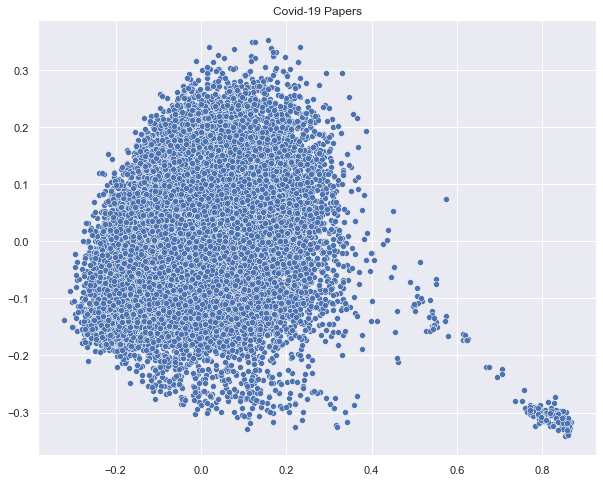

In [200]:
sns.set(rc={'figure.figsize': (10,8)})
sns.scatterplot(X_pca[:,0], X_pca[:, 1])
plt.title('Covid-19 Papers');

## Definição do número de clusters

- Fast K-means: https://www.researchgate.net/publication/51929167_Fast_K-Means_Algorithm_Clustering

In [201]:
from sklearn.cluster import MiniBatchKMeans

Text(0, 0.5, 'WCSS')

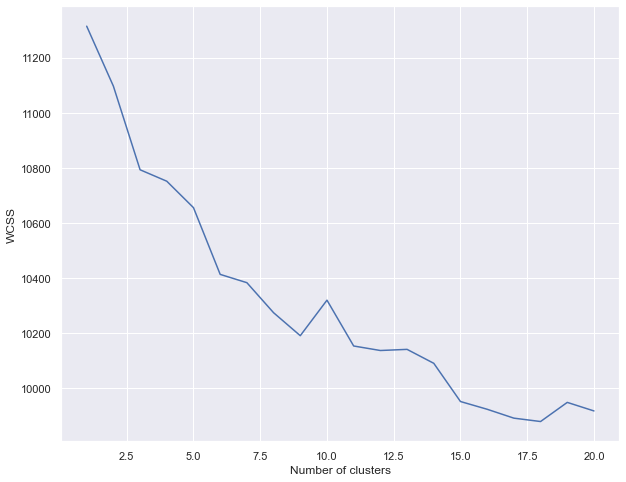

In [211]:
wcss = []
for i in range(1, 21):
  kmeans = MiniBatchKMeans(n_clusters = i, random_state = 0)
  kmeans.fit(vectorized)
  wcss.append(kmeans.inertia_)
plt.plot(range(1, 21), wcss)
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')

## Agrupamento com k-means

In [228]:
k = 5
kmeans = MiniBatchKMeans(n_clusters=k)
y_pred = kmeans.fit_predict(vectorized)

In [229]:
np.unique(y_pred)

array([0, 1, 2, 3, 4])

In [230]:
len(y_pred)

20211

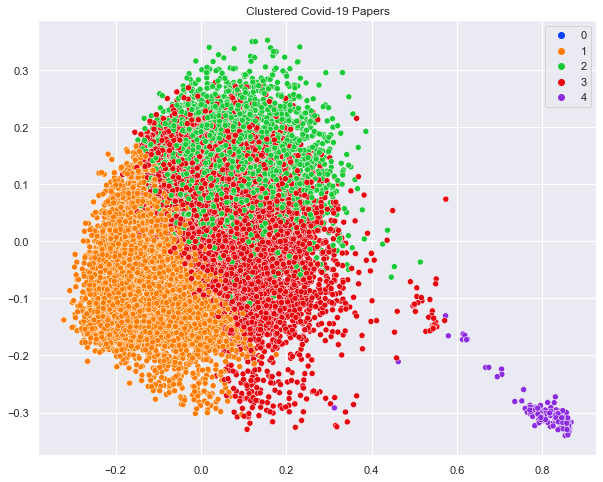

In [231]:
palette = sns.color_palette('bright', len(set(y_pred)))
sns.scatterplot(X_pca[:,0], X_pca[:, 1], hue=y_pred, legend='full', palette=palette)
plt.title('Clustered Covid-19 Papers');

# Sumarização dos textos

## Testes com a função

In [235]:
corona_df_original = pd.read_csv('./datasets/corona_df_completo.csv')

In [236]:
corona_df_original.shape

(20211, 5)

In [237]:
corona_df_original.head()

,Unnamed: 0,paper_id,title,abstract,text
0,0,0015023cc06b5362d332b3baf348d11567ca2fbb,The RNA pseudoknots in foot-and-mouth disease virus are dispensable for genome replication but e...,word count: 194 22 Text word count: 5168 23 24 25 author/funder. All rights reserved. No reuse a...,"VP3, and VP0 (which is further processed to VP2 and VP4 during virus assembly) (6). The P2 64 an..."
1,2,00d16927588fb04d4be0e6b269fc02f0d3c2aa7b,"Real-time, MinION-based, amplicon sequencing for lineage typing of infectious bronchitis virus f...",Infectious bronchitis (IB) causes significant economic losses in the global poultry industry. Co...,"Infectious bronchitis (IB), which is caused by infectious bronchitis virus (IBV), is one of the ..."
2,3,0139ea4ca580af99b602c6435368e7fdbefacb03,A Combined Evidence Approach to Prioritize Nipah Virus Inhibitors,"Nipah Virus (NiV) came into limelight recently due to an outbreak in Kerala, India. NiV causes s...",Nipah is an infectious negative-sense single-stranded RNA virus which belongs to the genus henip...
3,4,013d9d1cba8a54d5d3718c229b812d7cf91b6c89,"Assessing spread risk of Wuhan novel coronavirus within and beyond China, January-April 2020: a ...","Background: A novel coronavirus (2019-nCoV) emerged in Wuhan City, China, at the end of 2019 and...","In December 2019, a cluster of patients with pneumonia of unknown cause were reported in the cit..."
4,5,01d162d7fae6aaba8e6e60e563ef4c2fca7b0e18,"TWIRLS, an automated topic-wise inference method based on massive literature, suggests a possibl...","Faced with the current large-scale public health emergency, collecting, sorting, and analyzing b...",The sudden outbreak of the new coronavirus (SARS-CoV-2) at the end of December 2019 poses a huge...


In [240]:
!pip install bert-extractive-summarizer

You should consider upgrading via the 'c:\python39\python.exe -m pip install --upgrade pip' command.


In [242]:
from summarizer import Summarizer

ModuleNotFoundError: No module named 'summarizer'

In [ ]:
text = str(corona_df_original['text'][0])
print(text)

In [ ]:
len(text)

In [ ]:
model = Summarizer()

In [ ]:
result = model(text)

In [ ]:
result

In [ ]:
result = ''.join(result)
print(result)

In [ ]:
len(result)